<a href="https://colab.research.google.com/github/nsharan2000/Project-AgroCaptain/blob/main/image_segmentation_opencv_complete.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# this code is found using an online resource: https://github.com/MuonRay/Image-VideoSegmentationinNIRforPlantDetection

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install opencv-python

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib import ticker
from matplotlib.colors import LinearSegmentedColormap


cap = cv2.VideoCapture('/content/drive/MyDrive/archive/Image-VideoSegmentationinNIRforPlantDetection-master/testvideos/nirtestvideo.mp4')

In [ ]:
#custom colormap for ndvi greyscale video

cols3 = ['gray', 'blue', 'green', 'yellow', 'red']

def create_colormap(args):
    return LinearSegmentedColormap.from_list(name='custom1', colors=cols3)

#colour bar to match grayscale units
def create_colorbar(fig, image):
        position = fig.add_axes([0.125, 0.19, 0.2, 0.05])
        norm = colors.Normalize(vmin=-1., vmax=1.)
        cbar = plt.colorbar(image,
                            cax=position,
                            orientation='horizontal',
                            norm=norm)
        cbar.ax.tick_params(labelsize=6)
        tick_locator = ticker.MaxNLocator(nbins=3)
        cbar.locator = tick_locator
        cbar.update_ticks()
        cbar.set_label("NDVI", fontsize=10, x=0.5, y=0.5, labelpad=-25)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in true_divide


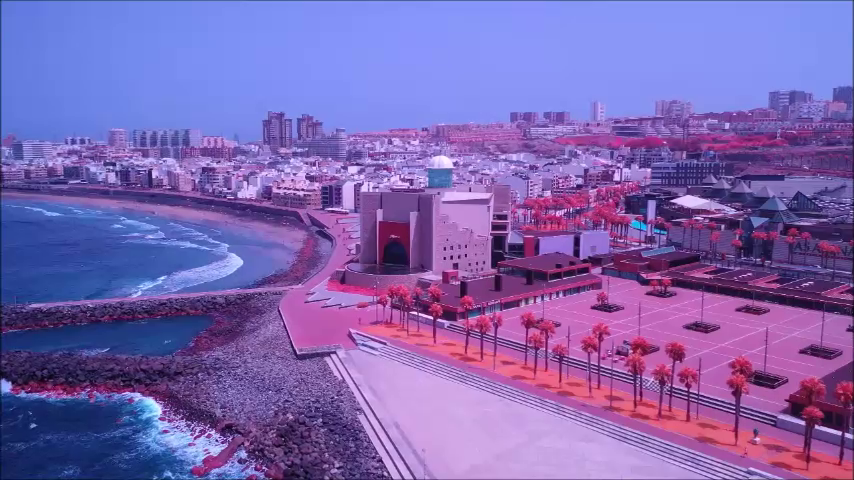

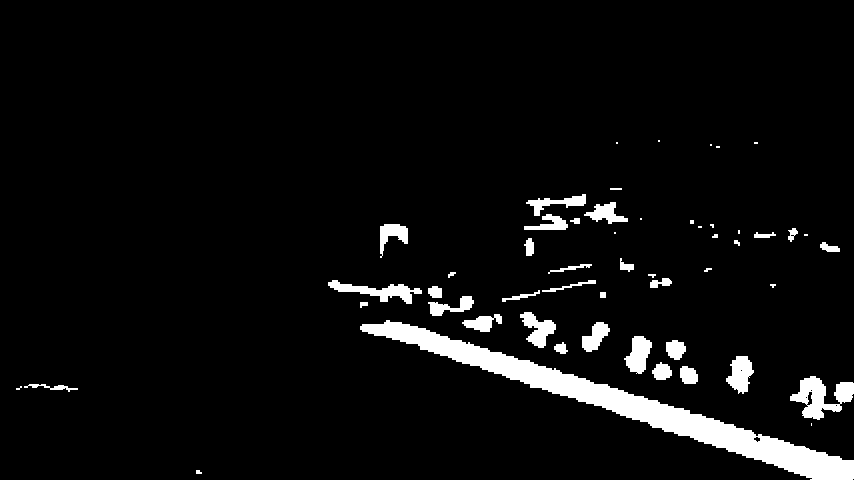

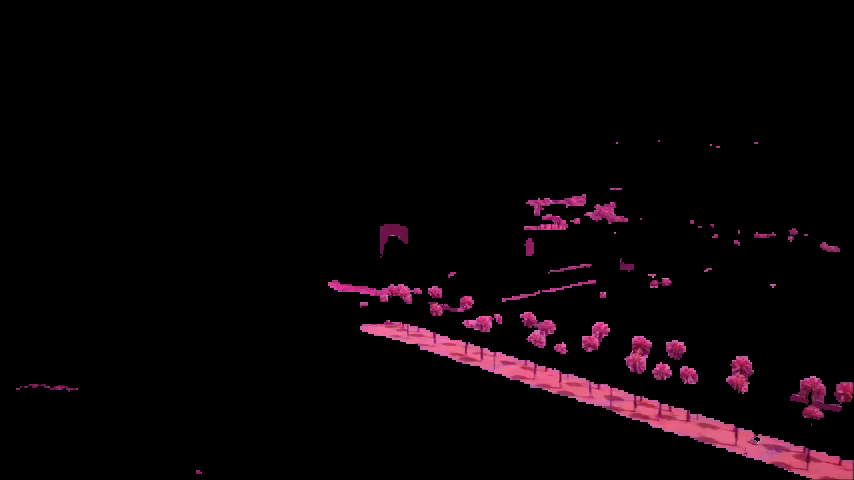

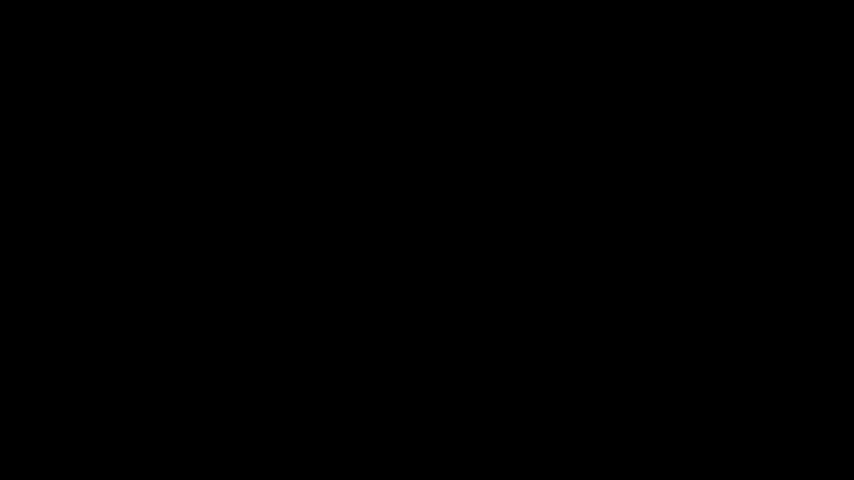

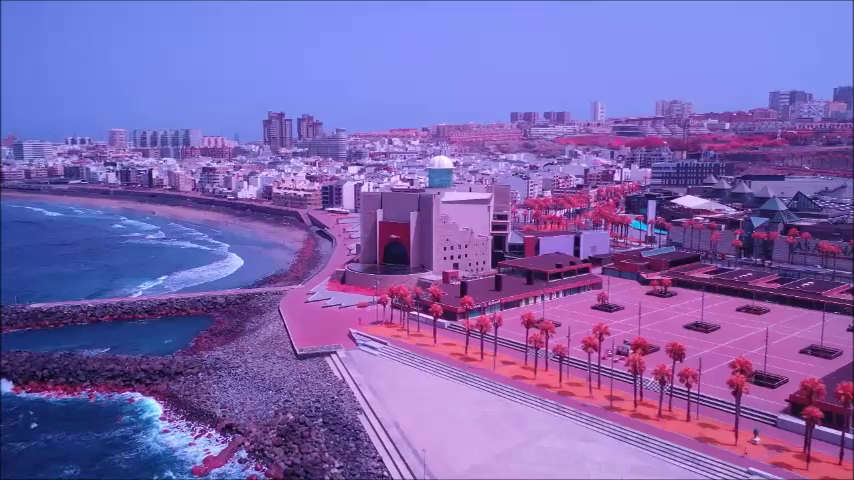

...

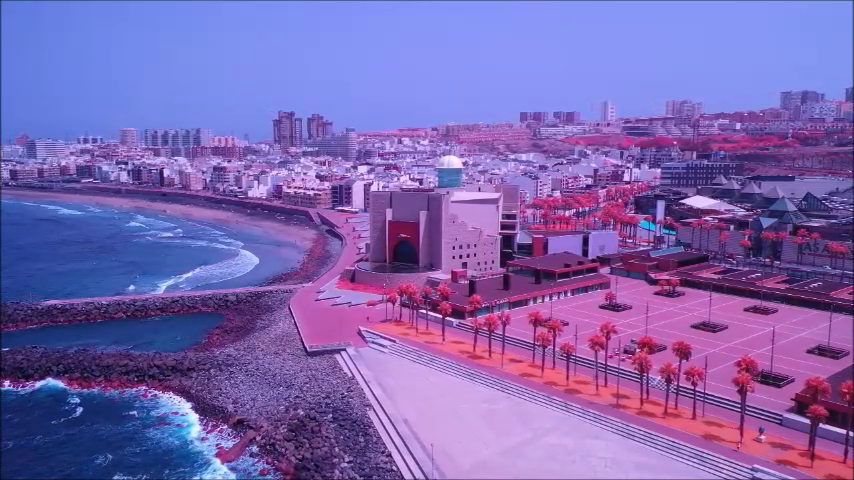

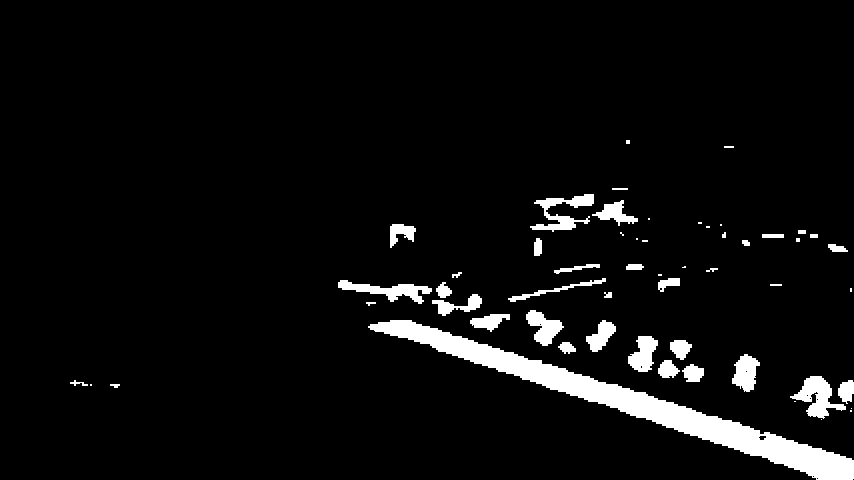

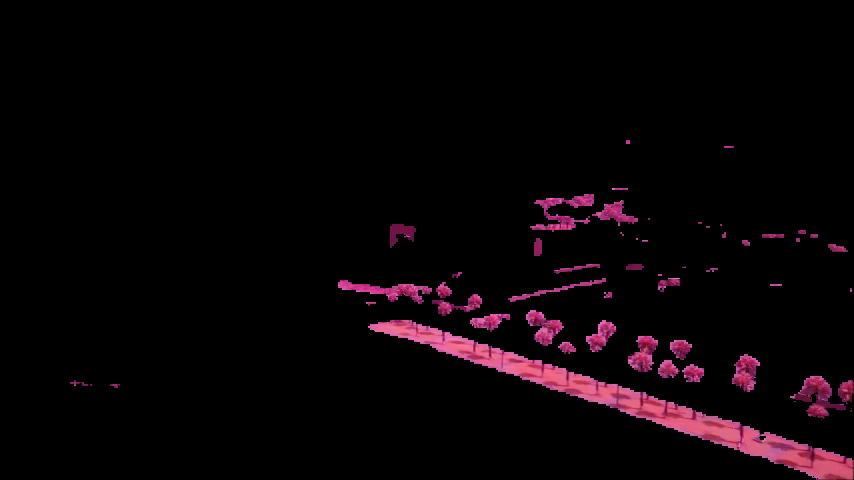

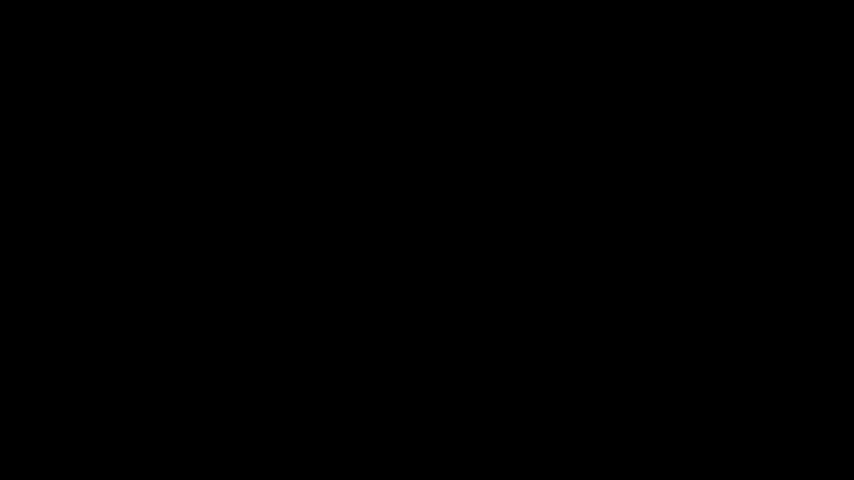

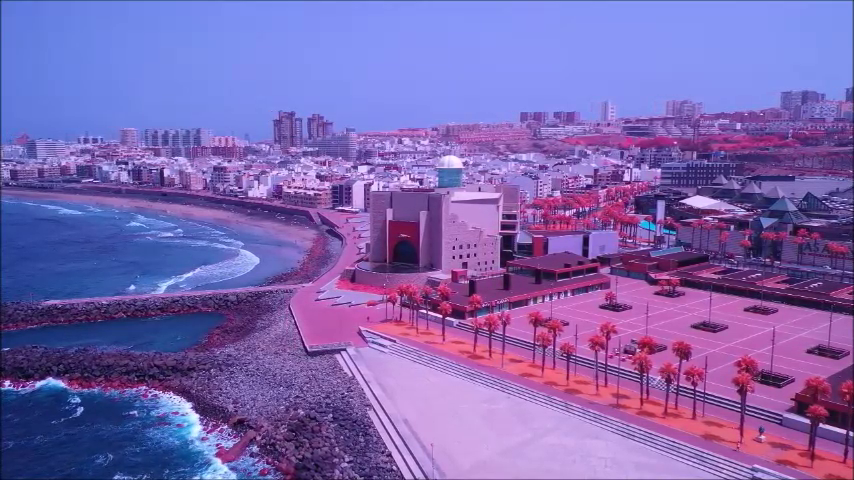

In [ ]:
from google.colab.patches import cv2_imshow

while(1):

    # Take each frame
    _, frame = cap.read()

    # Convert BGR to HSV
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    # define range of red NIR vegetation color in HSV
    low_red = np.array([160, 105, 84])
    high_red = np.array([179, 255, 255])

    # Threshold the HSV image to get only red colors
    mask = cv2.inRange(hsv, low_red, high_red)

    # Bitwise-AND mask and original image
    res = cv2.bitwise_and(frame,frame, mask= mask)
    
    
    #NDVI Processing
    ir = (res[:,:,0]).astype('float')
    r = (res[:,:,2]).astype('float')
    
    ndvi = np.true_divide(np.subtract(ir, r), np.add(ir, r))
    
    cols3 = ['gray', 'blue', 'green', 'yellow', 'red']
    
    def create_colormap(args):
        return LinearSegmentedColormap.from_list(name='custom1', colors=cols3)
    
    #colour bar to match grayscale units
    def create_colorbar(fig, image):
        position = fig.add_axes([0.125, 0.19, 0.2, 0.05])
        norm = colors.Normalize(vmin=-1., vmax=1.)
        cbar = plt.colorbar(image,
                            cax=position,
                            orientation='horizontal',
                            norm=norm)
        cbar.ax.tick_params(labelsize=6)
        tick_locator = ticker.MaxNLocator(nbins=3)
        cbar.locator = tick_locator
        cbar.update_ticks()
        cbar.set_label("NDVI", fontsize=10, x=0.5, y=0.5, labelpad=-25)

    
    
    image = plt.imshow(ndvi, cmap=create_colormap(colors))
    #plt.axis('off')
    #image = cv2.imshow(ndvi, cmap=create_colormap(colors))


    cv2_imshow(frame)
    cv2_imshow(mask)
    cv2_imshow(res)
    

    #this step adds considerable processing, be sure to use only 720p files at most a minute long
    #cv2.imshow('ndvi',ndvi)
    
    cv2_imshow(ndvi)




    k = cv2.waitKey(5) & 0xFF
    if k == 27:
        break

cv2.destroyAllWindows()